In [14]:
# we import all our libraries
import pandas as pd
import geopandas as gpd
import osmnx as ox
import matplotlib.pyplot as plt
import plotly as py
from shapely.geometry import Point, Polygon
import plotly.express as px
import numpy as np

%matplotlib inline

In [15]:
# We read both the airbnb and bbga file to our programme
airbnb_df = pd.read_csv('./listings.csv')
bbga_df = pd.read_csv('./bbga.csv', sep=';')

C:\Users\julia\AppData\Local\Temp\ipykernel_34568\3945712872.py:3: DtypeWarning: Columns (15,16,17,18,21,22,26,28,32,43,44,45,46,47,48,49,50,51,53,65,66,67,68,69,72,78,87,88,89,111,119,121,123,125,127,130,132,136,138,140,143,145,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,197,198,199,206,207,208,209,210,211,212,214,216,222,227,240,241,242,243,244,245,248,249,250,254,255,256,257,258,259,262,263,264,265,266,267,273,276,277,278,279,280,281,282,283,284,285,298,299,300,301,302,303,304,333,335,336,337,338,342,343,360,361,362,364,367,369,405,442,443,447,448,450,454,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,494,495,496,497,498,499,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,625,626,627,628,629,630,631,632,633,634,635,636,637,638,639,640,641,642,643,644,645,668,674,676,684,702,703,704,705,708,710,711,712,714,716,718,720,722,724,736,737,738,739,741,742,757,758,759,760,761,769,770,771,772,776

Paris is hosting the Paralympics in 2024. One of the events at the Paralympics is an open water
swimming event in the Seine (apparently the water is clean or so the French say). Since the City
of Amsterdam thinks it is beter than Paris, they want to host an event before the Paralympics,
snubbing the Parisians. The idea is to host a 5km. open water swimming event through the
canals of Amsterdam. You are asked by the municipality of Amsterdam to advise on the
feasibility of the event from the perspective of the safety of the partaking athletes from an
environmental perspective. The event is going to be hosted in May.

For this exercise you need the data from this website. Download the Basis Bestand Gebieden
Amsterdam (BBGA), both the data and the documentation. You already have the AirBnB data
from Amsterdam from the workshop exercise.

The Municipality of Amsterdam is in a love hate relationship with AirBnb, see for example this
and this article. Amsterdam wants to get a bit of insight in the number of tourists that will
make use of AirBnB. Can you advise on or calculate for Amsterdam:

- What Amsterdam will receive from tourist tax if the event lasts a week and you will
have 30.000 visitors?

In [16]:
# In amsterdam the tax is 3 euros and we assume a stay of 6 night since the arrival and depature day would be included in the 7
tourist_tax = 3 * 30000 * 6

# Furthermore, there is a tax of 7% on the price of the room
# To calculate this, we first calculate the average price of an airbnb per night
airbnb_avg_price = np.average(airbnb_df['price'])

# If we consider that, on average, 2 people will stay per AirBNB, we can calculate the total tax
tax_room = 0.07 * airbnb_avg_price * 15000 * 6

# So if all 30 000 visitors would stay in an AirBNB, the total tax would be:
print("The total tourist tax earned by Amsterdam from the 30.000 visitors would be: " + str(np.round(tourist_tax + tax_room)) + "€")

The total tourist tax earned by Amsterdam from the 30.000 visitors would be: 2143286.0€


- Plot the amount of AirBnB locations per neighbourhood

In [17]:
# to establish the distribution of airbnb across neighbouhood we use value count to see how many 
# there are in each category which is here defines as neighbouhoods
df_neighbourhood = airbnb_df['neighbourhood'].value_counts().reset_index().rename(columns={"index": 'neighbourhood', 0 : 'count'})
print(df_neighbourhood)

                             neighbourhood  count
0                   De Baarsjes - Oud-West   1382
1                             Centrum-West   1006
2                  De Pijp - Rivierenbuurt    935
3                             Centrum-Oost    793
4                                     Zuid    599
5                               Westerpark    584
6                                 Oud-Oost    506
7                            Bos en Lommer    424
8                                Oud-Noord    402
9   Oostelijk Havengebied - Indische Buurt    320
10                         Watergraafsmeer    262
11                              Noord-West    218
12                IJburg - Zeeburgereiland    183
13                             Slotervaart    164
14                              Noord-Oost    137
15                 Geuzenveld - Slotermeer    116
16                  Buitenveldert - Zuidas    100
17                  De Aker - Nieuw Sloten     74
18                   Gaasperdam - Driemond     51


In [19]:
# here we set up the distribution in a bargraph from higest to lowest
figure = px.bar(df_neighbourhood, x='neighbourhood', y='count', title='Distribution of airbnb across neighbourhoods', color='neighbourhood')
figure.show()
figure.write_html("./airbnb distribution.html")

Overall we can see that the centrum area and the areas close to the museum square have ny far the most airbnbs. While less touristy areas or less connected areas such as the bijmer are futher away

In [25]:
#here we set up a geodata frame based on the airbnb data set and do so with lat and long as geo location
gpd_airbnb = gpd.GeoDataFrame(airbnb_df[["id", "neighbourhood", "license"]], geometry=gpd.points_from_xy(airbnb_df.longitude, airbnb_df.latitude), crs = "WGS84")
print(gpd_airbnb.head())

       id neighbourhood                   license                  geometry
0  761411    Noord-Oost  0363 D4AD DCF3 E72A 56A2  POINT (4.95106 52.40164)
1  768274    Westerpark  0363 7A50 18E7 51D1 B7F9  POINT (4.88521 52.38855)
2  768737    Westerpark      036396BE30827DDB9575  POINT (4.86826 52.37824)
3  771217          Zuid  0363 D807 AD6C 499A F871  POINT (4.84802 52.34091)
4  771343  Centrum-West  0363 8C61 E9B9 5582 913E  POINT (4.88303 52.37641)


In [26]:
# here we call the street network in amsterdam
city_name = "Amsterdam"
G = ox.graph_from_place(city_name)

In [27]:
#here we visualize the map with roads in amsterdam and a point for the airbnbs
fig, ax = plt.subplots(figsize=(200,200))
ax.set_aspect('equal')
ax.set_facecolor('white')

ox.plot_graph(G, edge_color='#818589',
                        node_size=0, edge_linewidth=5
                        show=False, close=False, ax=ax,
                        )
gpd_airbnb.plot(ax=ax, color ="#FF5733", markersize = 200)


plt.savefig("airbnb distribution.png")

- Which street in Amsterdam has the most AirBnB apartments

In [28]:
# here we try to geocode the adresses so we first import relevant libraries
import reverse_geocoder as rg
from geopy.geocoders import Nominatim
# the input for the loop needs to be a strign which contains lat and long with a comma inbetween. So here we createa new column in our data set
# which takes both lat and long columns convertss them to a string and put them together
airbnb_df["coord"] = airbnb_df.latitude.astype(str) + ", " + airbnb_df.longitude.astype(str)

#then we read the previously made new columns to a list
coordinates = airbnb_df["coord"].tolist()

#we then create an empty list to read into
result = []
print(coordinates_top)

# now this fore loop goes through the coordinates in my list and converts them to adresses
geolocator = Nominatim(user_agent="my_app")

for i in coordinates:
    # We reverse code the adress
    address = geolocator.reverse(i)
    # we call the adress part of the output from the geocoder and split the string based on commas since thats between every column
    split_data = address.address.split(',')
    #to guarantee the same lenght column across the the board we take the first 7 columns, from studying the output given earlier
    # we know that the street is always within the first few columns
    short_data = split_data[:7]
    #then we add the new sub list into our main list
    result.append(short_data)
print(result)
 # try to make it a string column in short, try to add it to a data frame try with severl


ModuleNotFoundError: No module named 'geopy'

In [ ]:
# here we take the previosu nested list and convert it to a data frame for easy overview
adresses = pd.DataFrame(result, columns= ['1', '2', '3', '4', '5', '6', '7'])
print(adresses)

                                 1                              2  \
0          Gemaal Jisperveldstraat               Jisperveldstraat   
1                               82                 Zoutkeetsplein   
2                              125     Centrale Groothandelsmarkt   
3                              66E                     IJsbaanpad   
4     Grachtengordel van Amsterdam   Derde Egelantiersdwarsstraat   
...                            ...                            ...   
8381                          225A          Johan van Hasseltkade   
8382                         37A-1                  Meidoornplein   
8383                Natuur is leuk                     Brettenpad   
8384                   Hotel Doria                      Pijlsteeg   
8385               Boterdiepstraat                      Rijnbuurt   

                           3            4               5               6  \
0                      Noord   Zunderdorp       Amsterdam   Noord-Holland   
1             Zee

In [ ]:
# a visual analysis of the data shows me that street names 
#are in the first 3 columns thus i add them to one long column and the do value count fo that
# then i see the top results and check for the first one which is an actual street 
# while this approach thus leads to quite a bit of nois since the formattign of adresses is not the same for every coordinates
#it allows for an easy identeification of the main street

#here we make one long list with all fetaures in first 3 columns
adresses_rel = pd.concat([adresses['1'], adresses['2'], adresses['3']])
print(adresses_rel)

# we do vaue count to see which names appear the most often
count = adresses_rel.value_counts()
print(count.head(20)) # we print the top 20 lines to find the first which is a street
print('Based on previous estimation Nassaukade has the most AirBnBs with 183 Airbnbs registered there')

0            Gemaal Jisperveldstraat
1                                 82
2                                125
3                                66E
4       Grachtengordel van Amsterdam
                    ...             
8381                           Noord
8382                       Volewijck
8383                      Sloterdijk
8384           Burgwallen-Oude Zijde
8385                            Zuid
Length: 25158, dtype: object
 Oost                           450
 Centrum                        425
 Oud-West                       416
 Jordaan                        375
 De Pijp                        364
 Noord                          364
 Zuid                           350
 West                           347
 Staatsliedenbuurt              339
 Amsterdam                      330
 Kinkerbuurt                    287
 De Baarsjes                    279
 Landlust                       211
Grachtengordel van Amsterdam    207
 Indische Buurt                 195
 Grachtengordel         

- Try to cross reference the data from the AirBnB dataset with the BBGA. Can you figure
out if all apartments of AirBnB are designated as housing? Which number of
apartments are not rented out all the time but are also used as normal housing?

In [ ]:
#to compare the two different data sets, we did an initial visual analysis of the data
# this allowded us to see that there are only a few rows and colums which are relevant
#to us in the bbga data set, consequently we cut it in both dorection to make it more
#managabel. We then save it as a csv
bbga_airbnb_df = bbga_df[['gebiednaam', 'sdnaam', 'BHVESTAIRBNB']]

bbga_airbnb_df_GWW = bbga_airbnb_df.iloc[3937:3962]

bbga_airbnb_df_GWW.to_csv("bbga_short.csv", index = False)

print(bbga_airbnb_df_GWW)

                                 gebiednaam      sdnaam  BHVESTAIRBNB
3937                           Centrum-West     Centrum        3525.0
3938                           Centrum-Oost     Centrum        2766.0
3939                             Westerpark        West        2125.0
3940                          Bos en Lommer        West        1551.0
3941                  Oud West, De Baarsjes        West        4868.0
3942                  Sloterdijk Nieuw-West  Nieuw-West          18.0
3943                 Geuzenveld, Slotermeer  Nieuw-West         375.0
3944                                 Osdorp  Nieuw-West         270.0
3945          De Aker, Sloten, Nieuw-Sloten  Nieuw-West         204.0
3946                            Slotervaart  Nieuw-West         616.0
3947                               Oud-Zuid        Zuid        2045.0
3948                  Buitenveldert, Zuidas        Zuid         408.0
3949                 De Pijp, Rivierenbuurt        Zuid        3593.0
3950                

In [30]:
# here to compare the two different data sets the neighbouhood need to have
# the same name. Consequently we use the replace function to take the old name 
# and assimilate it to the new name. We then print it to make sure it works
bbga_short_df = pd.read_csv('./bbga_short.csv')
bbga_short_df.replace({ "Oud West, De Baarsjes" :"De Baarsjes - Oud-West",
            "De Pijp, Rivierenbuurt":"De Pijp - Rivierenbuurt",
            "Indische Buurt, Oostelijk Havengebied" : "Oostelijk Havengebied - Indische Buurt",
            "IJburg, Zeeburgereiland" : "IJburg - Zeeburgereiland",
            "Geuzenveld, Slotermeer" : "Geuzenveld - Slotermeer",
            "Buitenveldert, Zuidas" : "Buitenveldert - Zuidas",
            "Oud-Zuid" : "Zuid" ,
            "De Aker, Sloten, Nieuw-Sloten" : "De Aker - Nieuw Sloten",
             "Gaasperdam" : "Gaasperdam - Driemond"}, inplace = True)


print(bbga_short_df)

                                gebiednaam      sdnaam  BHVESTAIRBNB
0                             Centrum-West     Centrum        3525.0
1                             Centrum-Oost     Centrum        2766.0
2                               Westerpark        West        2125.0
3                            Bos en Lommer        West        1551.0
4                   De Baarsjes - Oud-West        West        4868.0
5                    Sloterdijk Nieuw-West  Nieuw-West          18.0
6                  Geuzenveld - Slotermeer  Nieuw-West         375.0
7                                   Osdorp  Nieuw-West         270.0
8                   De Aker - Nieuw Sloten  Nieuw-West         204.0
9                              Slotervaart  Nieuw-West         616.0
10                                    Zuid        Zuid        2045.0
11                  Buitenveldert - Zuidas        Zuid         408.0
12                 De Pijp - Rivierenbuurt        Zuid        3593.0
13                                

In [54]:
# here we set up a bar graph which compares both data sets and sees how many components are there per neighbouhood
graph = px.bar(bbga_short_df, x='gebiednaam', y='BHVESTAIRBNB', barmode='group', title="Comparison of AirBnBs in Amsterdam per data set", text_auto=True)
graph.add_bar(x=df_neighbourhood['neighbourhood'], y=df_neighbourhood['count'], name="AirBNB dataset", text=df_neighbourhood['count'])

graph.show()

This difference might be understood in light with how the data is collected the BBGA counts all houses/rooms which at some point in the last year have been offerd up on airbnb. Thus this might include houses which are no longer on airbnb. On the other hand the airbnb shows a momentary snapshot in time, thus only houses which are currently on the platform. Thus the municipal number since it collects numbers over a larger timeframe inevitably will be higher and show more houses. Fuhtermore the data comes from 2 different years since the bbga is from 2022 while the airbnb data is from september in 2023

To see wether or not an airbnb be is also used a as a house we consider the vairbale availabilit_365. This variable presumably showes how many days a place is available on airbnb and thus to what extend it is also used for other means.

Text(0, 0.5, 'amount of airbnbs')

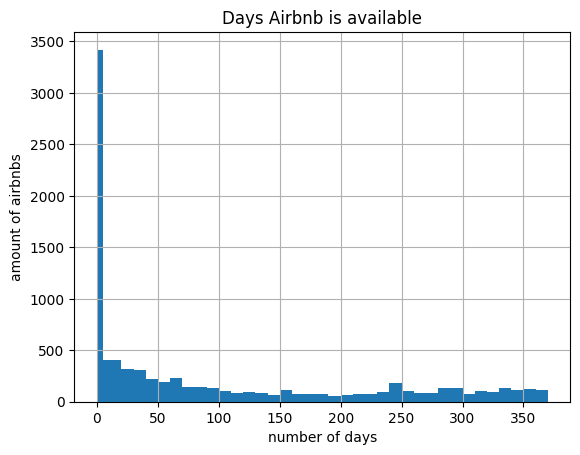

In [24]:
# we set up a histogram to show how much the different airbnbs are occupied and thus wether theya re also used as houses
airbnb_df.hist(column='availability_365', bins=[0, 5, 10, 20, 30, 40, 50, 60, 70, 80, 90, 100, 110, 120, 130, 140, 150, 160, 170, 180, 190, 200, 210, 220, 230, 240, 250, 260, 270, 280, 300, 310, 320, 330, 340, 350, 360, 370])

# Set the title and axis labels
plt.title('Days Airbnb is available')
plt.xlabel('number of days')
plt.ylabel('amount of airbnbs')

Here we can see that absolutly most houses on airbnb are actually rented out for less than 5 days and then it drops off rapidly and proceeds to level ut. So while some houses are indeed rentet out predominatly on airbnb and liekly not used for housing, most houses are only airbnbs temporarily liekly to have the house be cocupied when the owners are not around.

- How many hotel rooms should be built if Amsterdam wants to accommodate the same
number of tourists?

In [20]:
# we create a new list with only airbnbs which have been online for more than 0 nights so minimum 1 day
# and then we count how many items are in our list to see how many airbnbs this counts for
airbnb_more_0 = airbnb_df[airbnb_df['availability_365'] > 0]
#print(airbnb_more_0.head())
airbnb_availe = len(airbnb_more_0)
print(airbnb_availe)
#some numbers show that the average bnb offers aorund 3 rooms, so we will assume 3 guests to anser this question
people_airbnb = airbnb_availe * 3
print(people_airbnb)
#standard hotel rooms have 2 beds which is the assumption for the next calculaition
hotel_rooms = people_airbnb/2
print(hotel_rooms)

5438
16314
8157.0


- How many different licenses are issued?

In [46]:
airbnb_df

# Here we create a list of licences which is a copy of the column licenses in the airbnb data set wiht all the duplicates removed
license = list(set(airbnb_df["license"])) 

# then we print legth of the new list which is the amount of different licenses in our previous data set
print("The number of licences after removing duplicates :" + str(len(license)))

The number of licences after removing duplicates :7289
